In [ ]:
!pip install pyLDAvis
!pip install -U gensim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import re
import numpy as np
import pandas as pd
import os
import codecs
import glob
from pprint import pprint
# Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim import models
from gensim.models import CoherenceModel
import spacy
# Plotting tools
import matplotlib.pyplot as plt
%matplotlib inline
# Enable logging for gensim - optional
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.ERROR)
import warnings
warnings.filterwarnings("ignore",category=DeprecationWarning)
import pyLDAvis.gensim_models
import seaborn as sns
from functools import partial
from tqdm import tqdm
tqdm = partial(tqdm, position=0, leave=True)
from matplotlib.font_manager import FontProperties as font

In [ ]:
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stop_words = set(stopwords.words("english"))
len(stop_words)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


179

In [ ]:
stop_words=stop_words.union(['i','d','claim','plaintiff','defendant','allege','court','allegation','see','act','case','evidence','state','fact','cir','law','motion','testify','tr','steve','summary','judgment','section','litigation','district','dismiss','party','argue','plead','cite','action','amend','statement','assert','page','quote','opinion','argument','rule','citation','count','trial','report','testimony','jury','statute','use','also','class','show','find','make','include','issue','complaint','file','require','order','fail','omit','part','however','even','determine','result','question','federal','regard'])
len(stop_words)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


245

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
font1 = font(fname="/content/drive/MyDrive/kaiu.ttf")

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/usr/local/lib/python3.10/dist-packages/pexpect/popen_spawn.py:60: DeprecationWarning: setDaemon() is deprecated, set the daemon attribute instead
  self._read_thread.setDaemon(True)


Mounted at /content/drive


In [ ]:
data = pd.read_csv('/content/drive/MyDrive/Data/Data/entry.csv')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
os.getcwd()
os.chdir('/content/drive/MyDrive/text')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
data

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,case name,cite,type,jurisdiction,court,date decided,year
0,United States v. American Tobacco Co.,221 U.S. 106,221 U.S. 106_opinion,U.S. Federal,Supreme Court of the United States,1911/5/29,1911
1,United States v. American Tobacco Co.,221 U.S. 106,221 U.S. 106_dissent,U.S. Federal,Supreme Court of the United States,1911/5/29,1911
2,United States v. United States Steel Corp.,223 F. 55,223 F. 55_opinion,U.S. Federal,"District Court, D. New Jersey",1915/6/3,1915
3,United States v. United States Steel Corp.,223 F. 55,223 F. 55_concur,U.S. Federal,"District Court, D. New Jersey",1915/6/3,1915
4,United States v. Eastman Kodak Co.,226 F. 62,226 F. 62_opinion,U.S. Federal,"District Court, W.d. New York",1915/8/24,1915
...,...,...,...,...,...,...,...
2359,"In re Pandora Media, LLC Copyright Litig.",2022 U.S. Dist. LEXIS 198694,2022 U.S. Dist. LEXIS 198694_opinion,U.S. Federal,United States District Court for the Central D...,2022/10/26,2022
2360,"Techmatic, Inc. v. Plating Specialists, Inc.",2022 U.S. Dist. LEXIS 196560,2022 U.S. Dist. LEXIS 196560_opinion,U.S. Federal,United States District Court for the Middle Di...,2022/10/28,2022
2361,United States v. Bertelsmann SE & Co.,2022 U.S. Dist. LEXIS 202847,2022 U.S. Dist. LEXIS 202847_opinion,U.S. Federal,United States District Court for the District ...,2022/10/31,2022
2362,"Am. Proteins, Inc. N/K/A Crossroads Props. A, ...",2022 U.S. Dist. LEXIS 205688,2022 U.S. Dist. LEXIS 205688_opinion,U.S. Federal,United States District Court for the Northern ...,2022/11/8,2022


In [ ]:
data['path']=data['type']+'.txt'

In [ ]:
a=[]
for i in data['path']:
  a.append(open(i, "r").read())
data['content']=a
data

,case name,cite,type,jurisdiction,court,date decided,year,path,content
0,United States v. American Tobacco Co.,221 U.S. 106,221 U.S. 106_opinion,U.S. Federal,Supreme Court of the United States,1911/5/29,1911,221 U.S. 106_opinion.txt,"This suit was commenced on July 19, 1907, by t..."
1,United States v. American Tobacco Co.,221 U.S. 106,221 U.S. 106_dissent,U.S. Federal,Supreme Court of the United States,1911/5/29,1911,221 U.S. 106_dissent.txt,[*189] MR. JUSTICE HARLAN concurring in part a...
2,United States v. United States Steel Corp.,223 F. 55,223 F. 55_opinion,U.S. Federal,"District Court, D. New Jersey",1915/6/3,1915,223 F. 55_opinion.txt,"[*57] Before BUFFINGTON, HUNT, McPHERSON and W..."
3,United States v. United States Steel Corp.,223 F. 55,223 F. 55_concur,U.S. Federal,"District Court, D. New Jersey",1915/6/3,1915,223 F. 55_concur.txt,"WOOLLEY, Circuit Judge, with whom HUNT, Circui..."
4,United States v. Eastman Kodak Co.,226 F. 62,226 F. 62_opinion,U.S. Federal,"District Court, W.d. New York",1915/8/24,1915,226 F. 62_opinion.txt,"[*63] HAZEL, District Judge. This is a bill i..."
...,...,...,...,...,...,...,...,...,...
2359,"In re Pandora Media, LLC Copyright Litig.",2022 U.S. Dist. LEXIS 198694,2022 U.S. Dist. LEXIS 198694_opinion,U.S. Federal,United States District Court for the Central D...,2022/10/26,2022,2022 U.S. Dist. LEXIS 198694_opinion.txt,ORDER RE: MOTION TO DISMISS (ECF NO. 49)\nCoun...
2360,"Techmatic, Inc. v. Plating Specialists, Inc.",2022 U.S. Dist. LEXIS 196560,2022 U.S. Dist. LEXIS 196560_opinion,U.S. Federal,United States District Court for the Middle Di...,2022/10/28,2022,2022 U.S. Dist. LEXIS 196560_opinion.txt,Presently before the court are (1) the Renewed...
2361,United States v. Bertelsmann SE & Co.,2022 U.S. Dist. LEXIS 202847,2022 U.S. Dist. LEXIS 202847_opinion,U.S. Federal,United States District Court for the District ...,2022/10/31,2022,2022 U.S. Dist. LEXIS 202847_opinion.txt,"John Steinbeck famously said, ""I guess there a..."
2362,"Am. Proteins, Inc. N/K/A Crossroads Props. A, ...",2022 U.S. Dist. LEXIS 205688,2022 U.S. Dist. LEXIS 205688_opinion,U.S. Federal,United States District Court for the Northern ...,2022/11/8,2022,2022 U.S. Dist. LEXIS 205688_opinion.txt,This case comes before the Court on Defendants...


In [ ]:
def sent_to_words(sentences):
  for sentence in sentences:
    yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))
#將每個句子標記為一個單詞列表，完全刪除標點符號和不必要的字元，小寫化單詞。deacc=True刪除標點符號

In [ ]:
data_words = list(sent_to_words(data.content))
print(data_words[0])

['this', 'suit', 'was', 'commenced', 'on', 'july', 'by', 'the', 'united', 'states', 'to', 'prevent', 'the', 'continuance', 'of', 'alleged', 'violations', 'of', 'the', 'first', 'and', 'second', 'sections', 'of', 'the', 'anti', 'trust', 'act', 'of', 'july', 'the', 'defendants', 'were', 'twenty', 'nine', 'individuals', 'named', 'in', 'the', 'margin', 'sixty', 'five', 'american', 'corporations', 'most', 'of', 'them', 'created', 'in', 'the', 'state', 'of', 'new', 'jersey', 'and', 'two', 'english', 'corporations', 'for', 'convenience', 'of', 'statement', 'we', 'classify', 'the', 'corporate', 'defendants', 'exclusive', 'of', 'the', 'two', 'foreign', 'ones', 'which', 'we', 'shall', 'hereafter', 'separately', 'refer', 'to', 'as', 'follows', 'the', 'american', 'tobacco', 'company', 'new', 'jersey', 'corporation', 'because', 'of', 'its', 'dominant', 'relation', 'to', 'the', 'subject', 'matter', 'of', 'the', 'controversy', 'as', 'the', 'primary', 'defendant', 'five', 'other', 'new', 'jersey', 'cor

In [ ]:
# Build the bigram and trigram models
bigram = gensim.models.Phrases(data_words, min_count=1, threshold=1) # higher threshold fewer phrases.
#Bigrams是文件中經常出現的兩個詞。如'front_bumper'，'oil_leak'，'maryland_college_park'等
#min_count 和 threshold 。這些引數的值越高，將單詞組合成雙字母組的難度就越大。
# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
#Phraser的目的是通過丟棄一些Phasers模型（phrases_model），減少短語的内存消耗。如果後面不需要用新文檔更新bigram統計信息，就可以使用Phraser代替Phrases。一次性初始化後，Phraser会比使用Phrases模型占用内存小且速度更快。

In [ ]:
def remove_stopwords(texts):
  return [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]
def make_bigrams(texts):
  return [bigram_mod[doc] for doc in texts]
def lemmatization(texts, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
  """https://spacy.io/api/annotation"""
  texts_out = []
  for sent in texts:
    doc = nlp(" ".join(sent))
    texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])#.pos_為詞性
  return texts_out
#.lemma_詞形還原(lemmatization)是指去掉單詞的詞形詞缀，返回單詞原型，
#例如對於動詞來說，就是去掉動詞的過去式、過去完成式等形式，返回動詞原型；對於名詞來說，則是去掉名詞的複數形式，返回名詞原型；對於形容词來說，則是去掉比較級、最高級等形式，返回形容詞原型。

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
nlp = spacy.load('en_core_web_sm', disable=['parser', 'ner']) #disable參數是禁用的處理管道列表，例如，創建en_core_web_sm語言模型，並禁用ner
# Do lemmatization keeping only noun, adj, vb, adv
data_lemmatized = lemmatization(data_words, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV'])
# Remove Stop Words
data_words_nostops = remove_stopwords(data_lemmatized)
# Form Bigrams
data_words_bigrams = make_bigrams(data_words_nostops)

print(data_words_bigrams[0])

['suit', 'commence', 'prevent', 'continuance', 'violation', 'first', 'second', 'individual', 'name', 'margin', 'american', 'corporation', 'create', 'english', 'corporation', 'convenience', 'classify', 'corporate', 'exclusive', 'foreign', 'one', 'hereafter', 'separately_refer', 'follow_american', 'tobacco_company', 'dominant_relation', 'subject_matter', 'controversy', 'primary', 'company', 'company', 'conley_foil', 'company', 'relation', 'controversy', 'accessory', 'american', 'corporation_subsidiary', 'ground', 'american_tobacco', 'company', 'rest', 'alone', 'nature', 'character', 'corporation', 'power', 'exert', 'directly', 'accessory', 'corporation_subsidiary', 'corporation_stock', 'ownership', 'corporation', 'control', 'exercise', 'subsidiary', 'company', 'virtue', 'stock', 'hold', 'say', 'company', 'accessory', 'company', 'stock_ownership', 'american_tobacco', 'company', 'exert_power', 'control', 'accessory', 'company', 'impleade', 'nature', 'character', 'power', 'exert', 'stock_ow

In [ ]:
print(f"總文章數：{len(data_lemmatized)} 篇")
print(f"平均文章詞數：{sum(map(lambda x: len(x), data_lemmatized)) / len(data_lemmatized)} 詞")

總文章數：2364 篇
平均文章詞數：4276.986463620981 詞


In [ ]:
# Create Dictionary
id2word = corpora.Dictionary(data_words_bigrams)

# Create Corpus
texts = data_words_bigrams
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]
#（0,1）暗示，單詞id 0在第一個文件中出現一次。同樣，單詞id 1出現兩次，依此類推。

In [ ]:
id2word.dfs

{1091: 846,
 194: 309,
 1160: 1538,
 861: 1211,
 263: 50,
 53: 174,
 479: 1521,
 987: 1353,
 988: 1518,
 314: 1533,
 575: 985,
 724: 640,
 680: 165,
 1022: 27,
 65: 329,
 282: 783,
 294: 1235,
 1048: 1625,
 402: 22,
 274: 213,
 1049: 957,
 179: 118,
 281: 350,
 440: 662,
 485: 252,
 764: 394,
 536: 51,
 999: 421,
 929: 921,
 482: 1445,
 373: 368,
 933: 480,
 1069: 280,
 273: 300,
 866: 595,
 737: 53,
 201: 1371,
 66: 1,
 662: 1,
 232: 1,
 7: 48,
 1074: 455,
 521: 69,
 959: 607,
 60: 787,
 729: 1050,
 166: 335,
 848: 1444,
 446: 177,
 343: 1024,
 1075: 12,
 62: 1647,
 271: 1293,
 445: 889,
 1188: 296,
 1056: 348,
 544: 1554,
 982: 1038,
 558: 3,
 1141: 1037,
 474: 1123,
 559: 1,
 1068: 1106,
 1058: 11,
 80: 37,
 1011: 1517,
 867: 531,
 116: 829,
 164: 1276,
 648: 651,
 968: 1540,
 487: 8,
 768: 807,
 385: 1474,
 267: 1114,
 51: 1295,
 37: 117,
 753: 275,
 685: 1414,
 1005: 719,
 664: 263,
 462: 1656,
 510: 63,
 19: 1555,
 52: 1491,
 1087: 386,
 714: 138,
 117: 145,
 776: 111,
 234: 610,

In [ ]:
print(id2word.token2id)

{'abandon': 0, 'able': 1, 'abnormal': 2, 'abroad': 3, 'absolutely': 4, 'abstraction': 5, 'accept': 6, 'accessory': 7, 'accomplish': 8, 'accomplishment': 9, 'accord': 10, 'accordance': 11, 'accordingly': 12, 'accurately': 13, 'acquire': 14, 'acquire_dominion': 15, 'acquisition': 16, 'act': 17, 'act_forbid': 18, 'action': 19, 'actively_engage': 20, 'activity': 21, 'actor': 22, 'acts_committe': 23, 'actual': 24, 'actually': 25, 'addition': 26, 'additional': 27, 'additionally': 28, 'adequate': 29, 'adhere': 30, 'adherence': 31, 'adjudge': 32, 'adoption': 33, 'advance': 34, 'advantageous': 35, 'advantageously': 36, 'affair': 37, 'affirm': 38, 'affirmative': 39, 'affirmatively': 40, 'affix': 41, 'afford': 42, 'afterwards': 43, 'agent': 44, 'agents_servant': 45, 'aggregate': 46, 'aggregated': 47, 'aggressive': 48, 'agree': 49, 'agreeing': 50, 'agreement': 51, 'allege': 52, 'alleged_violation': 53, 'allen': 54, 'allot': 55, 'allow': 56, 'allowance': 57, 'almost': 58, 'almost_immediately': 59, 

In [ ]:
[[(id2word[id], freq) for id, freq in cp] for cp in corpus[:]]

[[('abandon', 2),
  ('able', 1),
  ('abnormal', 1),
  ('abroad', 3),
  ('absolutely', 1),
  ('abstraction', 1),
  ('accept', 1),
  ('accessory', 12),
  ('accomplish', 6),
  ('accomplishment', 1),
  ('accord', 3),
  ('accordance', 1),
  ('accordingly', 1),
  ('accurately', 1),
  ('acquire', 34),
  ('acquire_dominion', 1),
  ('acquisition', 6),
  ('act', 49),
  ('act_forbid', 1),
  ('action', 7),
  ('actively_engage', 1),
  ('activity', 2),
  ('actor', 1),
  ('acts_committe', 1),
  ('actual', 1),
  ('actually', 3),
  ('addition', 2),
  ('additional', 2),
  ('additionally', 2),
  ('adequate', 4),
  ('adhere', 1),
  ('adherence', 1),
  ('adjudge', 7),
  ('adoption', 1),
  ('advance', 1),
  ('advantageous', 1),
  ('advantageously', 1),
  ('affair', 2),
  ('affirm', 2),
  ('affirmative', 1),
  ('affirmatively', 1),
  ('affix', 4),
  ('afford', 4),
  ('afterwards', 4),
  ('agent', 3),
  ('agents_servant', 2),
  ('aggregate', 3),
  ('aggregated', 2),
  ('aggressive', 1),
  ('agree', 5),
  ('ag

In [ ]:
# Build LDA model
lda_model = gensim.models.ldamulticore.LdaMulticore(
    corpus=corpus,
    id2word=id2word, # 字典
    num_topics=6, # 生成幾個主題數
    random_state=100, # 亂數
    chunksize= 100 ,
    passes=30, # 模型訓練次數
    per_word_topics= True,
    alpha= 'asymmetric',
    eta = 'auto'
)

In [ ]:
# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]
#貢獻0這個主題的前10個關鍵詞是：'market'，'power'，'evidence'等等，主題0上'market'的權重是0.032。

[(0,
  '0.016*"merger" + 0.015*"market" + 0.008*"company" + 0.008*"acquisition" + '
  '0.006*"product" + 0.006*"propose" + 0.006*"customer" + 0.006*"sale" + '
  '0.006*"competition" + 0.005*"government"'),
 (1,
  '0.017*"price" + 0.008*"market" + 0.008*"conspiracy" + 0.005*"expert" + '
  '0.005*"cost" + 0.005*"increase" + 0.005*"product" + 0.005*"member" + '
  '0.005*"damage" + 0.004*"antitrust"'),
 (2,
  '0.015*"service" + 0.013*"market" + 0.011*"hospital" + 0.009*"patient" + '
  '0.009*"redact" + 0.009*"network" + 0.006*"text" + 0.005*"plan" + '
  '0.005*"provider" + 0.005*"offer"'),
 (3,
  '0.007*"antitrust" + 0.006*"agreement" + 0.005*"patent" + 0.005*"market" + '
  '0.004*"conduct" + 0.004*"injury" + 0.004*"provide" + 0.004*"violation" + '
  '0.003*"conspiracy" + 0.003*"hold"'),
 (4,
  '0.024*"market" + 0.016*"product" + 0.008*"tie" + 0.007*"relevant_market" + '
  '0.007*"customer" + 0.006*"agreement" + 0.006*"sale" + 0.006*"market_power" '
  '+ 0.006*"competitor" + 0.005*"contrac

In [ ]:
print('\nPerplexity: ', lda_model.log_perplexity(corpus))
#log-likelihood（log-可能性）越高，也就意味著提取出的主題能表達特定主題的能力越好，這個提取出的主題質量也就越高，混淆度也就越小


Perplexity:  -8.873315473143323


In [ ]:
coherence_model_lda = CoherenceModel(model=lda_model, texts=data_words_bigrams , dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)
#來衡量一個主題內的詞是否是連貫的。如果這些詞是相互支撐的，那麼這組詞就是連貫的。


Coherence Score:  0.39140548303390105


In [ ]:
ldaVis = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary=lda_model.id2word, mds='mmds',sort_topics=False)
pyLDAvis.enable_notebook()
ldaVis
#pyLDAvis.save_html(ldaVis,'ldaVis.html')
#主題之間的距離即表示主題之間的相似性；另外每個主題被視覺化呈現為圓圈，圓圈的大小即表示主題出現的頻率，當圓圈越大，主題出現的頻率越大。一個好的主題模型會有大的、不重疊的氣泡
#λ越接近 1 時，會顯示在主題內越頻繁出現的字詞；反之，當λ越接近 0 時，則會出現在主題內越特殊的字詞，透過調節λ參數，來找到字詞與主題間的相關性。

/usr/local/lib/python3.9/dist-packages/pyLDAvis/_prepare.py:243: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(
/usr/local/lib/python3.9/dist-packages/sklearn/manifold/_mds.py:299: FutureWarning: The default value of `normalized_stress` will change to `'auto'` in version 1.4. To suppress this warning, manually set the value of `normalized_stress`.
  warnings.warn(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.076641  0.165681       1        1  10.370218
1      0.161871 -0.012277       2        1  20.522158
2     -0.230475  0.036163       3        1   6.350913
3      0.113595 -0.141830       4        1  31.527620
4      0.116182  0.138022       5        1  19.033058
5     -0.084533 -0.185759       6        1  12.196033, topic_info=           Term          Freq         Total Category  logprob  loglift
1057    service  26514.000000  26514.000000  Default  30.0000  30.0000
724      market  69130.000000  69130.000000  Default  29.0000  29.0000
743      merger  11764.000000  11764.000000  Default  28.0000  28.0000
909       price  31082.000000  31082.000000  Default  27.0000  27.0000
922     product  36558.000000  36558.000000  Default  26.0000  26.0000
...         ...           ...           ...      ...      ...      ...
56        allow   2092.491152   9395.868541   Topic6  -5.9649   0.6021
207     company   2361.556937  16117.015865   Topic6  -5.8439   0.1835
53    agreement   2434.225491  26229.806753   Topic6  -5.8136  -0.2732
82        apply   2113.825567  11800.015958   Topic6  -5.9547   0.3845
1589       base   2025.614146  18908.742433   Topic6  -5.9973  -0.1297

[486 rows x 6 columns], token_table=        Topic      Freq    Term
term                           
136577      4  0.998299  abbvie
5947        1  0.030315  access
5947        2  0.012310  access
5947        3  0.073490  access
5947        4  0.144040  access
...       ...       ...     ...
1286        2  0.196611    year
1286        3  0.054096    year
1286        4  0.227069    year
1286        5  0.178655    year
1286        6  0.084895    year

[1082 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2, 3, 4, 5, 6])

In [ ]:
topics_doc = lda_model.get_document_topics(corpus)

# 將結果列成list
doc_list = []

# topics_doc[i] 為第一個文章
for i in range(0,len(topics_doc)):

    # 都先假定第一個主題為最大的
    max_freq = topics_doc[i][0][1]
    max_topic = topics_doc[i][0][0]

    # 後面假如有比較大的就取代
    for j in topics_doc[i]:
        if(j[1] > max_freq):
            max_freq = j[1]
            max_topic = j[0]

    # print(max_topic)
    # print(max_freq)
    doc_list.append(max_topic)

In [ ]:
# 將結果放進 DataFrame裏
data['topic'] = doc_list

In [ ]:
# groupby 日期、主題並計算文章篇數
date_topic = pd.DataFrame({
    'count':data.groupby(['year','topic']).size()
})

date_topic = date_topic.reset_index()

In [ ]:
date_df = date_topic.pivot_table(index='year', values='count', columns='topic').fillna(0).reset_index()
date_df.columns = ['year', 'topic0', 'topic1', 'topic2', 'topic3', 'topic4', 'topic5']
date_df = date_df.set_index('year')
date_df

,topic0,topic1,topic2,topic3,topic4,topic5
year,,,,,,
1911,0.0,0.0,0.0,2.0,0.0,0.0
1915,0.0,2.0,0.0,1.0,0.0,0.0
1917,0.0,0.0,0.0,1.0,0.0,0.0
1920,0.0,0.0,0.0,2.0,0.0,0.0
1953,1.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...
2018,7.0,8.0,1.0,21.0,17.0,5.0
2019,0.0,12.0,1.0,29.0,15.0,4.0
2020,4.0,10.0,3.0,39.0,21.0,6.0


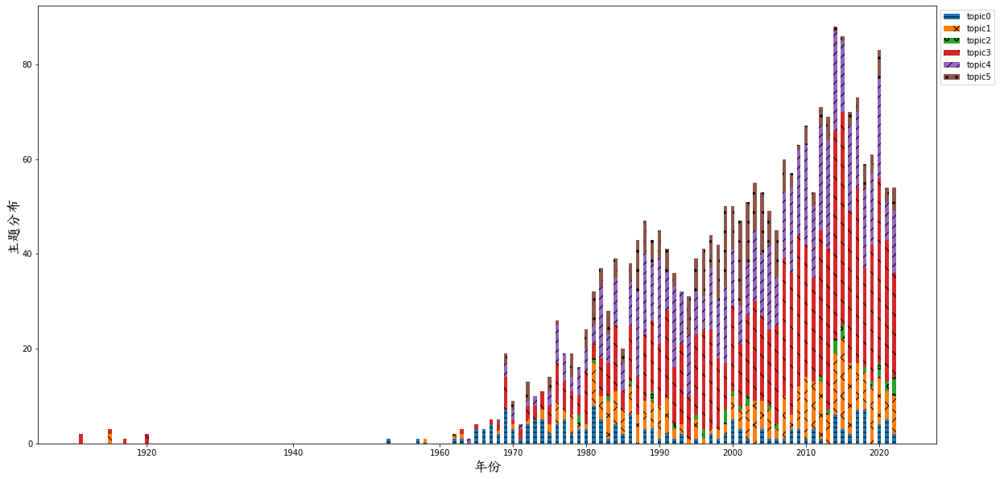

In [ ]:
plt.figure(figsize=(20,10))
hatch=['--', 'x', 'o', '\\', '//','.']
column = ['topic0', 'topic1', 'topic2', 'topic3', 'topic4', 'topic5']
temp_bottom = 0

for i in range(0,6):
    if(i>0):
        pass
        temp_bottom = temp_bottom + date_df[column[i-1]]
        plt.bar(date_df.index, date_df[column[i]] ,hatch=hatch[i], bottom=temp_bottom ,label=column[i] , width=0.5)
    else: # 主題一 bottom 為 0
        plt.bar(date_df.index, date_df[column[i]] ,hatch=hatch[i], label=column[i] , width=0.5)

#plt.title('每年論文篇數') # 標題
plt.xticks([1920,1940,1960,1970,1980,1990,2000,2010,2020])
plt.xlabel('年份',fontproperties=font1, fontsize=18) # x軸標題
plt.ylabel('主題分布',fontproperties=font1, fontsize=18) # y軸標題
#plt.xticks(rotation=30)
plt.legend(bbox_to_anchor=(1,1), loc='upper left') #標示的位置
plt.show()

In [ ]:
ratio_df = date_df.copy()
ratio_df['sum'] = ratio_df.topic0 + ratio_df.topic1 + ratio_df.topic2 + ratio_df.topic3 + ratio_df.topic4 + ratio_df.topic5

for i in range(0,6):
    ratio_df['topic'+str(i)] = ratio_df['topic'+str(i)] / ratio_df['sum']

ratio_df

,topic0,topic1,topic2,topic3,topic4,topic5,sum
year,,,,,,,
1911,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,2.0
1915,0.000000,0.666667,0.000000,0.333333,0.000000,0.000000,3.0
1917,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.0
1920,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,2.0
1953,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
...,...,...,...,...,...,...,...
2018,0.118644,0.135593,0.016949,0.355932,0.288136,0.084746,59.0
2019,0.000000,0.196721,0.016393,0.475410,0.245902,0.065574,61.0
2020,0.048193,0.120482,0.036145,0.469880,0.253012,0.072289,83.0


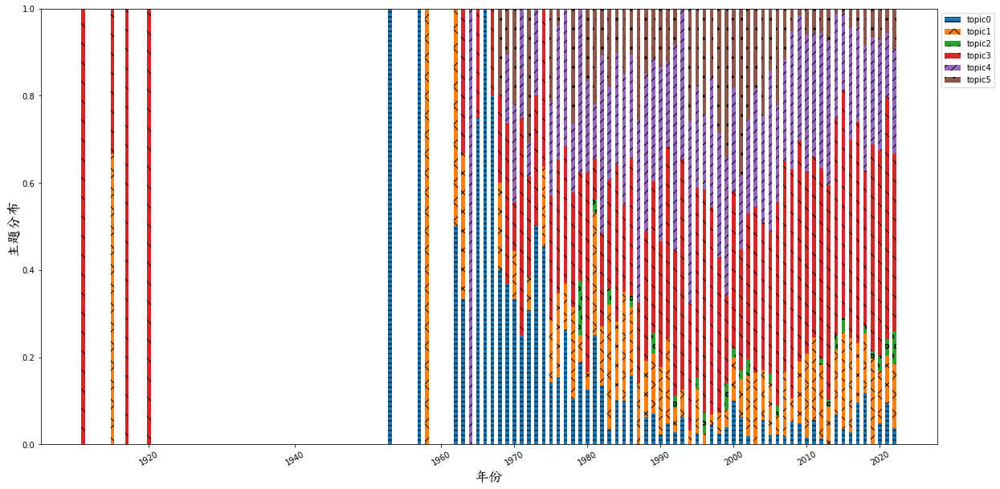

In [ ]:
plt.figure(figsize=(20,10))
temp_bottom = 0

for i in range(0,6):
    if(i>0):
        temp_bottom = temp_bottom + ratio_df[column[i-1]]
        plt.bar(ratio_df.index, ratio_df[column[i]] ,hatch=hatch[i], bottom=temp_bottom ,label=column[i], width=0.5)
    else: # 主題一 bottom 為 0
        plt.bar(ratio_df.index, ratio_df[column[i]] ,hatch=hatch[i], label=column[i], width=0.5)

#plt.title('每年論文篇數') # 標題
plt.xticks([1920,1940,1960,1970,1980,1990,2000,2010,2020])
plt.xlabel('年份',fontproperties=font1, fontsize=18) # x軸標題
plt.ylabel('主題分布',fontproperties=font1, fontsize=18) # y軸標題
plt.xticks(rotation=30)
plt.legend(bbox_to_anchor=(1,1), loc='upper left') #標示的位置
plt.show()

In [ ]:
## 主題一
data[data['topic'] == 0].sample(n=3)

/usr/local/lib/python3.9/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


KeyError: ignored

In [ ]:
number_of_topics = []
coherence_score = []
for i in tqdm(range(7,16)):
  lda_model = gensim.models.ldamulticore.LdaMulticore(corpus=corpus,
                                           id2word=id2word,
                                           random_state=100, # 亂數
                                           chunksize= 100 ,
                                           passes=10, # 模型訓練次數
                                           per_word_topics= True,
                                           num_topics=i)
  coherence_model_lda = CoherenceModel(model=lda_model,
                                       texts=data_words_bigrams,
                                       dictionary=id2word,
                                       coherence='c_v')
  coherence_lda = coherence_model_lda.get_coherence()
  number_of_topics.append(i)
  coherence_score.append(coherence_lda)

In [ ]:
# Create a dataframe of coherence score by number of topics
topic_coherence = pd.DataFrame({'number_of_topics':number_of_topics,'coherence_score':coherence_score})
topic_coherence

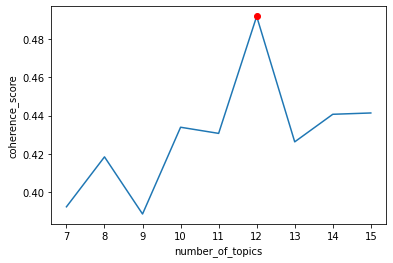

In [ ]:
# Print a line plot
sns.lineplot(data=topic_coherence, x='number_of_topics', y='coherence_score')
plt.plot(topic_coherence["coherence_score"].argmax()+7, topic_coherence["coherence_score"].max(), "or")

In [ ]:
def calculate_coherence_score(alpha, beta):
    lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=8,
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=10,
                                           alpha=alpha,
                                           per_word_topics=True,
                                           eta = beta)
    coherence_model_lda = CoherenceModel(model=lda_model, texts=data_words_bigrams, dictionary=id2word, coherence='c_v')
    coherence_lda = coherence_model_lda.get_coherence()
    return coherence_lda

#list containing various hyperparameters
alpha_list = [0.005,0.01,0.02]
beta_list = [0.005,0.01,0.02]


for alpha in alpha_list:
  for beta in beta_list:
    coherence_score = calculate_coherence_score( alpha, beta)
    print(f"alpha : {alpha} ; beta : {beta} ; Score : {coherence_score}")

alpha : 0.005 ; beta : 0.005 ; Score : 0.3998785906888015
alpha : 0.005 ; beta : 0.01 ; Score : 0.40354508876914263
alpha : 0.005 ; beta : 0.02 ; Score : 0.40333555445179226
alpha : 0.01 ; beta : 0.005 ; Score : 0.39920127561242835
alpha : 0.01 ; beta : 0.01 ; Score : 0.39908300023533866
alpha : 0.01 ; beta : 0.02 ; Score : 0.40538153291289825
alpha : 0.02 ; beta : 0.005 ; Score : 0.3972530947740711
alpha : 0.02 ; beta : 0.01 ; Score : 0.39628464754202575
alpha : 0.02 ; beta : 0.02 ; Score : 0.404092984862055
